<a href="https://colab.research.google.com/github/yugodon/InSAR/blob/main/SAR_Analysis_at_Sakurajima.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# PyGMTSARライブラリのインストール
import platform, sys, os
if 'google.colab' in sys.modules:
    # install PyGMTSAR stable version from PyPI
    !{sys.executable} -m pip install -q pygmtsar
    # alternatively, nstall PyGMTSAR development version from GitHub
    #!{sys.executable} -m pip install -Uq git+https://github.com/mobigroup/gmtsar.git@pygmtsar2#subdirectory=pygmtsar
    # use PyGMTSAR Google Colab installation script to install binary dependencies
    # script URL: https://github.com/AlexeyPechnikov/pygmtsar/blob/pygmtsar2/pygmtsar/pygmtsar/data/google_colab.sh
    import importlib.resources as resources
    with resources.as_file(resources.files('pygmtsar.data') / 'google_colab.sh') as google_colab_script_filename:
        !sh {google_colab_script_filename}
    # enable custom widget manager as required by recent Google Colab updates
    from google.colab import output
    output.enable_custom_widget_manager()
    # initialize virtual framebuffer for interactive 3D visualization; required for headless environments
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

# specify GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

# display PyGMTSAR version
from pygmtsar import __version__
__version__

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.6/97.6 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.9/61.9 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.0/105.0 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 33.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 46.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.2/243.2 kB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 39.2 MB/s eta 0:00:00
W: Skipping acquire of configured file 'main/source/Source

'2024.8.30.post5'

In [ ]:
# 基本ライブラリ
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json                              # JSON形式のデータを操作
from dask.distributed import Client      # Daskの分散処理環境を制御するためのクラス
import dask                              # 並列計算ライブラリ


# データのプロットや3Dビジュアライゼーションを行うための準備
import pyvista as pv                    # 3Dデータの可視化と操作
# magic trick for white background
pv.set_plot_theme("document")           # プロットを白背景に設定
import panel                            # インタラクティブな可視化の作成やウェブブラウザ上での3Dプロットの表示
panel.extension(comms='ipywidgets')     # Jupyter Notebook 上でインタラクティブなUIを作成可能にする
panel.extension('vtk')                  # pyvista を用いた3Dプロットを、ウェブやJupyter Notebook上でインタラクティブに表示可能にする
from contextlib import contextmanager
import matplotlib.pyplot as plt
@contextmanager
def mpl_settings(settings):
    original_settings = {k: plt.rcParams[k] for k in settings}
    plt.rcParams.update(settings)
    yield
    plt.rcParams.update(original_settings)
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 100
plt.rcParams['figure.titlesize'] = 24
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
%matplotlib inline


# Pandasライブラリのデータフレーム表示設定
pd.set_option('display.max_rows', None)     # 行数の最大値の設定
pd.set_option('display.max_columns', None)  # 列数の最大値の設定
pd.set_option('display.width', None)        # 文字数の指定
pd.set_option('display.max_colwidth', 100)  # 文字列の最大長を100文字に設定


# S1:Sentinel-1 SARデータの処理をサポートするモジュールまたはクラス。
# Stack:SARデータのスタック処理（複数時系列データの積み重ね）をサポートするモジュールまたはクラス。
# tqdm_dask:Daskタスクの進行状況を表示するツール。
# ASF:アラスカ衛星施設（ASF: Alaska Satellite Facility）に関連するデータ処理モジュール。
# Tiles:SARデータをタイル（小さな領域）に分割して管理するモジュールまたはクラス。
from pygmtsar import S1, Stack, tqdm_dask, ASF, Tiles

In [ ]:
# 部分的なシーンダウンロードにはサブスワス（subswath）が必要ですが、バーストダウンロードには使用されません。
# 軌道情報（orbit）はディレクトリ名を定義するために使用されます。
ORBIT    = 'D'
SUBSWATH = 12

# シーンの選択
# SCENES = ['S1A_IW_SLC__1SDV_20241222T211750_20241222T211816_057110_070560_D0BB',
#           'S1A_IW_SLC__1SDV_20241210T211751_20241210T211818_056935_06FE57_49FA']

# バーストの選択
BURSTS = """
S1_348852_IW2_20241222T211755_VV_D0BB-BURST
S1_348852_IW2_20241210T211756_VV_49FA-BURST
"""
BURSTS = list(filter(None, BURSTS.split('\n')))
print (f'Bursts defined: {len(BURSTS)}')

Bursts defined: 2


In [ ]:
# 変数ORBIT の値に基づいて、データを保存するディレクトリを条件分岐で設定
WORKDIR      = 'raw_lacumbre_desc'  if ORBIT == 'D' else 'raw_lacumbre_asc'
DATADIR      = 'data_lacumbre_desc' if ORBIT == 'D' else 'data_lacumbre_asc'

In [ ]:
# DEM と LANDMASK ファイルパスの設定
DEM = f'{DATADIR}/dem.nc'
LANDMASK = f'{DATADIR}/landmask.nc'

In [ ]:
# GeoJSON データの定義
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Polygon",
    "coordinates": [[
      [130.7235, 31.5889],
      [130.7222, 31.6],
      [130.7184, 31.6108],
      [130.7122, 31.6207],
      [130.7038, 31.6293],
      [130.6937, 31.6365],
      [130.682, 31.6417],
      [130.6694, 31.645],
      [130.6563, 31.6461],
      [130.6432, 31.645],
      [130.6306, 31.6417],
      [130.619, 31.6365],
      [130.6088, 31.6293],
      [130.6005, 31.6207],
      [130.5943, 31.6108],
      [130.5904, 31.6],
      [130.5892, 31.5889],
      [130.5904, 31.5777],
      [130.5943, 31.567],
      [130.6005, 31.5571],
      [130.6088, 31.5484],
      [130.619, 31.5413],
      [130.6306, 31.536],
      [130.6432, 31.5327],
      [130.6563, 31.5316],
      [130.6694, 31.5327],
      [130.682, 31.536],
      [130.6937, 31.5413],
      [130.7038, 31.5484],
      [130.7122, 31.5571],
      [130.7184, 31.567],
      [130.7222, 31.5777],
      [130.7235, 31.5889]
    ]]
  },
  "properties": {}
}
'''


# Geo DataFrameの作成
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])

In [ ]:
# Set these variables to None and you will be prompted to enter your username and password below.
asf_username = 'inoueyugodondon'
asf_password = 'Tonytony11360@'

In [ ]:
# ASF APIを通じて衛星データを直接取得し、解析のためにローカル環境に保存（必要最小限のデータのみダウンロード）
# Set these variables to None and you will be prompted to enter your username and password below.
asf = ASF(asf_username, asf_password)
# Optimized scene downloading from ASF - only the required subswaths and polarizations.
# Subswaths are already encoded in burst identifiers and are only needed for scenes.
#print(asf.download(DATADIR, SCENES, SUBSWATH))
print(asf.download(DATADIR, BURSTS))

ASF Downloading Bursts Catalog:   0%|          | 0/1 [00:00<?, ?it/s]

ASF Downloading Sentinel-1 Bursts:   0%|          | 0/2 [00:00<?, ?it/s]

                                burst_or_scene
0  S1_348852_IW2_20241222T211755_VV_D0BB-BURST
1  S1_348852_IW2_20241210T211756_VV_49FA-BURST


In [ ]:
# scan the data directory for SLC scenes and download missed orbits
S1.download_orbits(DATADIR, S1.scan_slc(DATADIR))

,orbit
0,S1A_OPER_AUX_POEORB_OPOD_20241230T070635_V20241209T225942_20241211T005942.EOF.zip
1,S1A_OPER_AUX_POEORB_OPOD_20250111T070631_V20241221T225942_20241223T005942.EOF.zip


Tiles Parallel Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

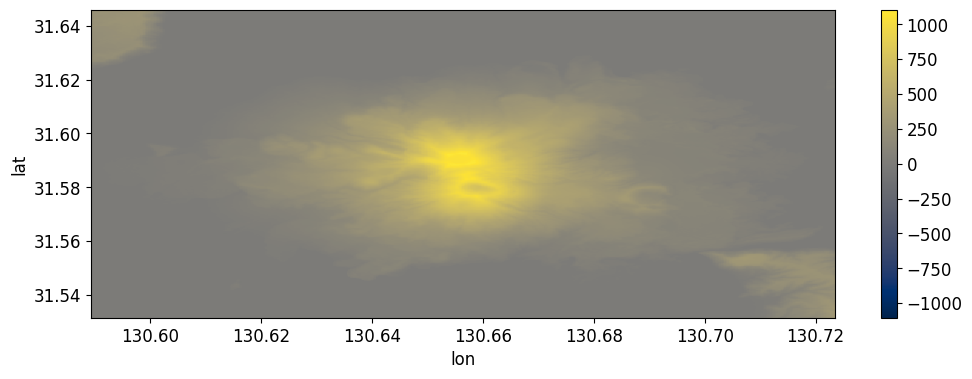

In [ ]:
# 関心領域（AOI）の標高データ（DEM）を可視化
Tiles().download_dem(AOI, filename=DEM).plot.imshow(cmap='cividis')

Tiles Parallel Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

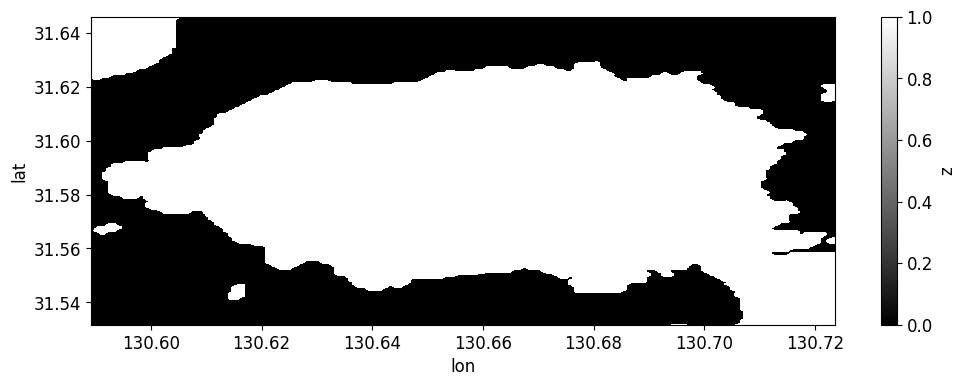

In [ ]:
# download land mask 1 arc-second
Tiles().download_landmask(AOI, filename=LANDMASK).fillna(0).plot.imshow(cmap='binary_r')

In [ ]:
# simple Dask initialization
if 'client' in globals():
    client.close()
client = Client()
client

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:41571
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:8787/status
INFO:distributed.scheduler:Registering Worker plugin shuffle
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:45443'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:46593'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:34419', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:34419
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:47498
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:34333', name: 0, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker co

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 2
Total threads: 2,Total memory: 12.67 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41571,Workers: 2
Dashboard: http://127.0.0.1:8787/status,Total threads: 2
Started: Just now,Total memory: 12.67 GiB
Comm: tcp://127.0.0.1:34333,Total threads: 1
Dashboard: http://127.0.0.1:38217/status,Memory: 6.34 GiB
Nanny: tcp://127.0.0.1:45443,


In [ ]:
scenes = S1.scan_slc(DATADIR, subswath=SUBSWATH)

In [ ]:
# SBAS解析を行うためにシーンのスタックを構築し、その情報をデータフレーム形式で出力
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes)
sbas.to_dataframe()

NOTE: auto set reference scene 2024-12-10. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,noisepath,calibpath,orbitpath,geometry
date,,,,,,,,,,,
2024-12-10,2024-12-10 21:17:56,D,S1A,VV,2,data_lacumbre_desc/S1A_IW_SLC__1SDV_20241210T211756_20241210T211759_056935_06FE57_49FA.SAFE/meas...,data_lacumbre_desc/S1A_IW_SLC__1SDV_20241210T211756_20241210T211759_056935_06FE57_49FA.SAFE/anno...,None,None,data_lacumbre_desc/S1A_OPER_AUX_POEORB_OPOD_20241230T070635_V20241209T225942_20241211T005942.EOF,"MULTIPOLYGON (((131.095 31.64712, 131.04688 31.65468, 130.99703 31.66248, 130.947 31.67029, 130...."
2024-12-22,2024-12-22 21:17:55,D,S1A,VV,2,data_lacumbre_desc/S1A_IW_SLC__1SDV_20241222T211755_20241222T211758_057110_070560_D0BB.SAFE/meas...,data_lacumbre_desc/S1A_IW_SLC__1SDV_20241222T211755_20241222T211758_057110_070560_D0BB.SAFE/anno...,None,None,data_lacumbre_desc/S1A_OPER_AUX_POEORB_OPOD_20250111T070631_V20241221T225942_20241223T005942.EOF,"MULTIPOLYGON (((131.09507 31.64712, 131.04695 31.65468, 130.99709 31.66248, 130.94707 31.67029, ..."


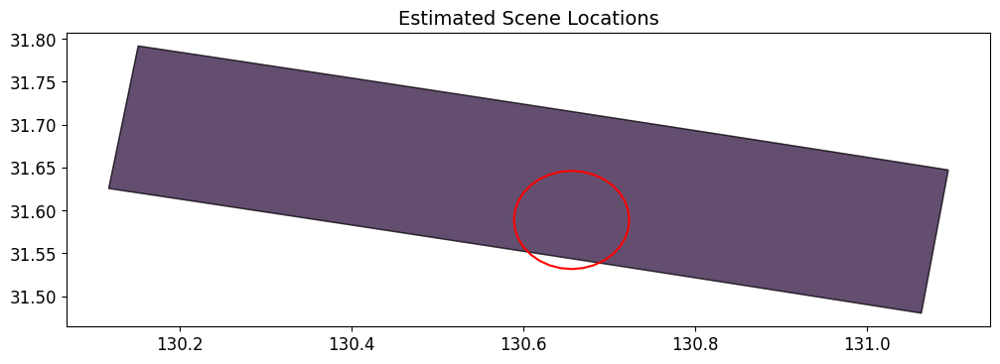

In [ ]:
sbas.plot_scenes(AOI=AOI, aspect='equal')

In [ ]:
sbas.compute_reframe(AOI)

Reframing:   0%|          | 0/2 [00:00<?, ?it/s]

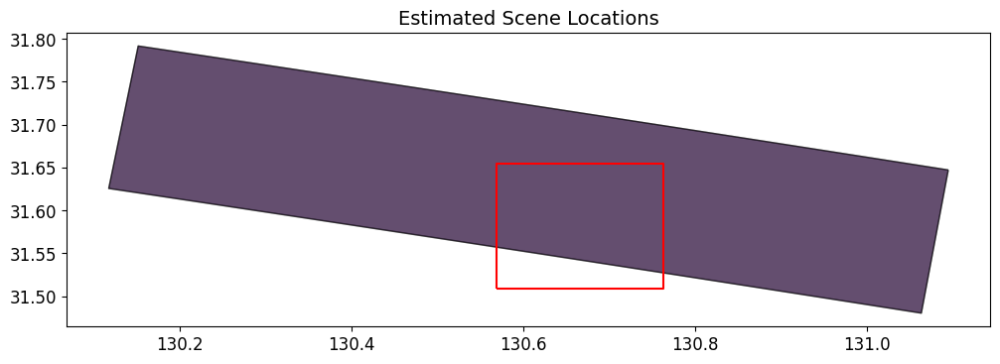

In [ ]:
sbas.plot_scenes(AOI=AOI, aspect='equal')

In [ ]:
# define the area of interest (AOI) to speedup the processing
sbas.load_dem(DEM, AOI)

Save DEM on WGS84 Ellipsoid:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-2e152600-d317-11ef-96f6-0242ac1c0002
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:37976


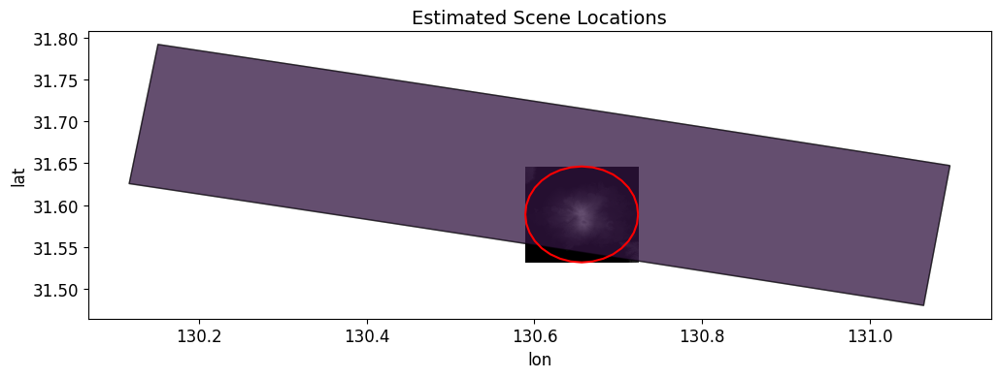

In [ ]:
sbas.plot_scenes(AOI=AOI, aspect='equal')

In [ ]:
sbas.load_landmask(LANDMASK)

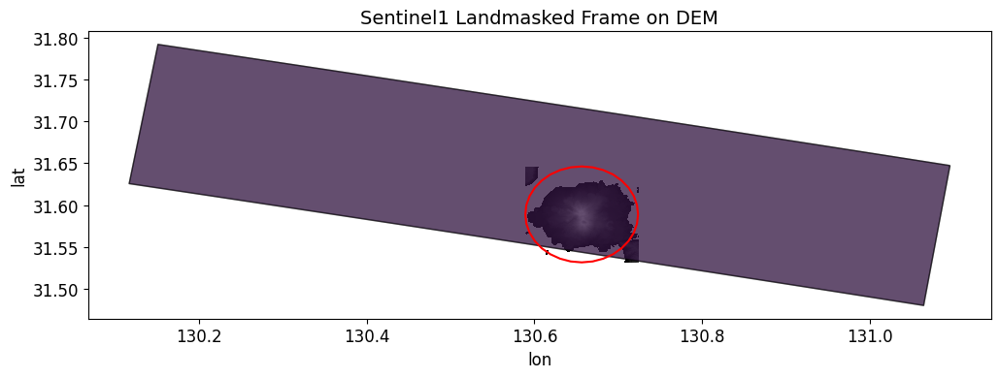

In [ ]:
sbas.plot_scenes(AOI=AOI, dem=sbas.get_dem().where(sbas.get_landmask()), caption='Sentinel1 Landmasked Frame on DEM', aspect='equal')
plt.savefig('Sentinel1 Landmasked Frame on DEM.jpg')

In [ ]:
# SBASスタックに含まれるSARデータシーンを幾何学的に整列（アラインメント）
sbas.compute_align()

Preparing Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# SBASスタック内のデータを地理座標系（ジオコーディング）に変換
sbas.compute_geocode(30.)

Radar Transform Computing:   0%|          | 0/1 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

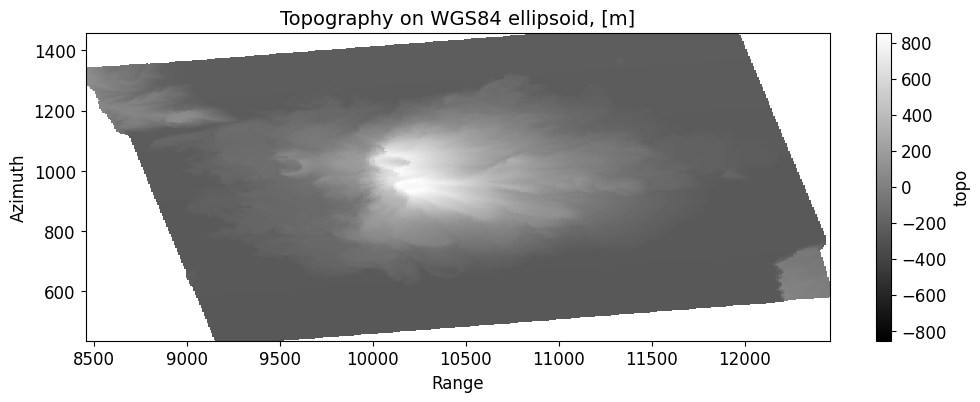

In [ ]:
sbas.plot_topo()
plt.savefig('Topography on WGS84 ellipsoid, [m].jpg')

In [ ]:
# for a pair of scenes only two interferograms can be produced
# this one is selected for scenes sorted by the date in direct order
pairs = [sbas.to_dataframe().index]
pairs

[Index(['2024-12-10', '2024-12-22'], dtype='object', name='date')]

In [ ]:
# Sentinel-1のSARデータを読み込む
data = sbas.open_data()

# レーダーの地形データ（DEM）を読み込む
topo = sbas.get_topo()

# Sentinel-1の強度データ（振幅の二乗）に対して、400mのカットオフ波長でガウスフィルタリングを適用し、
# 1x4のマルチルッキング（1ピクセル×4ピクセル単位での集約）を行う
intensity = sbas.multilooking(np.square(np.abs(data)), wavelength=60, coarsen=(2,8))

# 位相の計算
phase = sbas.phasediff(pairs, data, topo)

# 位相データに対して200mのカットオフ波長でガウスフィルタリングを適用し、
# 2x8のマルチルッキングを再度実行してデータを集約する
phase = sbas.multilooking(phase, wavelength=60, coarsen=(2,8))


# 位相データと強度データを使用して、約15mの分解能で相関（コヒーレンス）を計算する
# 1:4のレンジデシメーション（データの間引き）を適用
corr = sbas.correlation(phase, intensity)

# Goldsteinフィルタを適用（1:4レンジマルチルッキングで作成された正方格子セルに基づく32ピクセルのパッチサイズ）
phase_goldstein = sbas.goldstein(phase, corr, 16)

# 複素数の位相差データを干渉画像（インターフェログラム）に変換
intf = sbas.interferogram(phase_goldstein)

# 単一の干渉画像を具体化（結果を計算してメモリに保持）
tqdm_dask(result := dask.persist(intf[0], corr[0]), desc='位相と相関の計算')

# 結果をアンパック（解凍）
intf, corr = result

位相と相関の計算:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-687b4a2e-d317-11ef-96f3-0242ac1c0002
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48672


In [ ]:
# geocode
intf = sbas.cropna(sbas.ra2ll(intf))
corr = sbas.cropna(sbas.ra2ll(corr))
dem = sbas.get_dem().interp_like(intf).where(np.isfinite(intf))

In [ ]:
# load and fix landmask by patch
landmask = sbas.get_landmask().interp_like(intf).load()
selector = {'lat': slice(-0.4, -0.3), 'lon': slice(-91.6, -91.5)}
landmask.sel(selector).values[:] = 1
landmask = landmask.interp_like(intf)

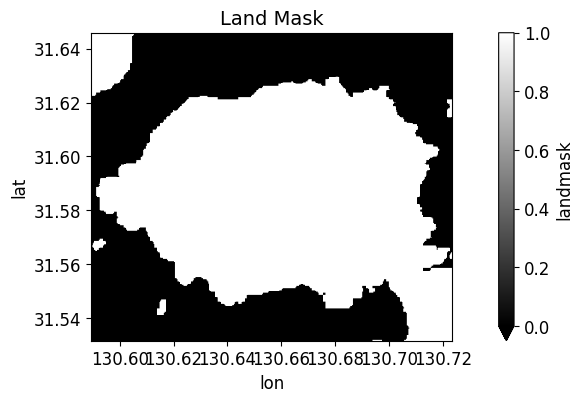

In [ ]:
sbas.plot_landmask(landmask, aspect='equal')

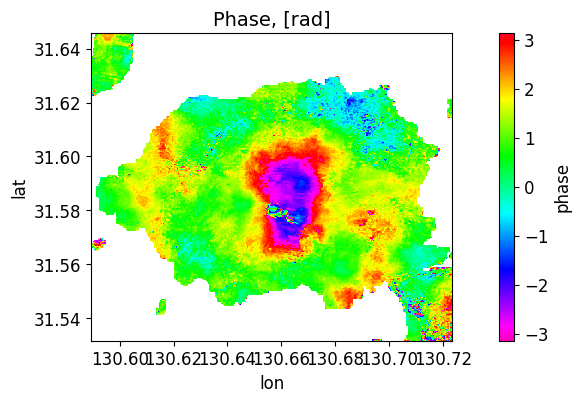

In [ ]:
sbas.plot_interferogram(intf.where(landmask), aspect='equal')
plt.savefig('Phase, [rad].jpg')

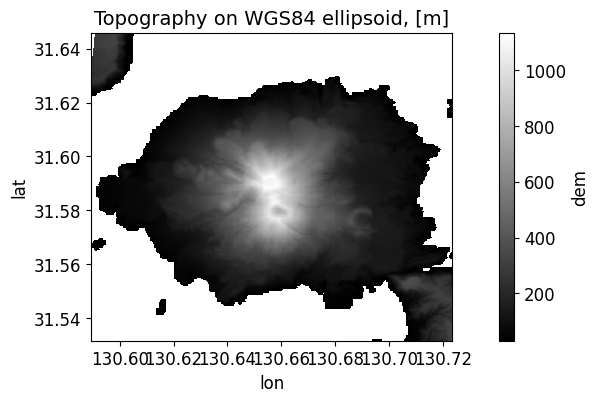

In [ ]:
sbas.plot_topo(dem.where(landmask), aspect='equal')

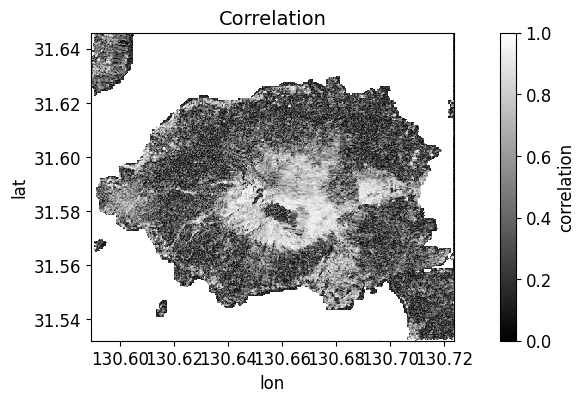

In [ ]:
sbas.plot_correlation(corr.where(landmask), aspect='equal')
plt.savefig('Correlation.jpg')

In [ ]:
# crop a small land patch at top right corner
from shapely.geometry import Polygon
AOI_buffer = AOI.buffer(0.05).exterior.apply(lambda ring: Polygon(ring))
intf_crop = sbas.as_geo(intf.where(landmask)).rio.clip(AOI_buffer)

sbas.export_vtk(intf_crop[::2,::2], 'intf', mask='auto')

Exporting WGS84 VTK(s):   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# build interactive 3D plot
plotter = pv.Plotter(notebook=True)
plotter.add_mesh(pv.read('intf.vtk').scale([1, 1, 0.00002], inplace=True), scalars='phase', cmap='turbo', ambient=0.1, show_scalar_bar=True)
plotter.show_axes()
plotter.show(screenshot='3D Interferogram.png', jupyter_backend='panel', return_viewer=True)
plotter.add_title(f'Interactive Interferogram on DEM', font_size=32)
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)


VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='2f3...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')

**Detrend Unwrapped Phase**


In [ ]:
# データの補正
aligned_corr = corr.interp_like(intf)  # corr を intf に合わせる


print("intf.shape:", intf.shape)
print("corr.shape:", aligned_corr.shape)

intf.shape: (446, 422)
corr.shape: (446, 422)


Remove trend and apply gaussian filter to fix ionospheric effects and solid Earh's tides.

In [ ]:
# mask low-coherence areas using threshold value 0.075
tqdm_dask(unwrap := sbas.unwrap_snaphu(intf.where(corr>=0.075), aligned_corr.where(corr>=0.075)).persist(),
          desc='SNAPHU Unwrapping')
# apply simplest detrending
unwrap['phase'] = unwrap.phase - unwrap.phase.mean()

SNAPHU Unwrapping:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
# geocode to geographic coordinates and crop empty borders
unwrap_ll = sbas.ra2ll(unwrap.phase)

NOTE: the input data not in radar coordinates, miss geocoding


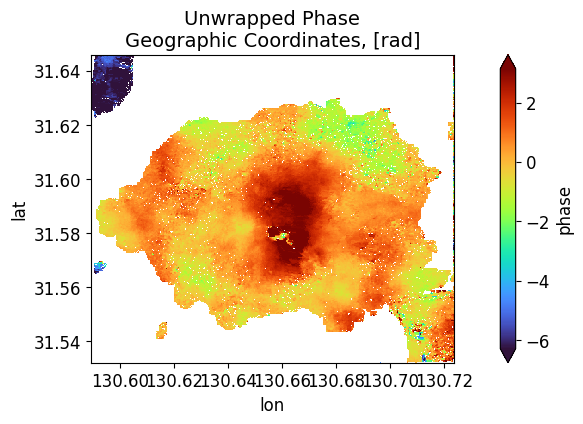

In [ ]:
sbas.plot_phase(unwrap_ll.where(landmask), caption='Unwrapped Phase\nGeographic Coordinates, [rad]', quantile=[0.02, 0.98], aspect='equal')
plt.savefig('Unwrapped Phase Geographic Coordinates, [rad].jpg')

In [ ]:
sbas.export_vtk(unwrap_ll.where(landmask), 'unwrap', mask='auto')

Exporting WGS84 VTK(s):   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# build interactive 3D plot
plotter = pv.Plotter(notebook=True)
plotter.add_mesh(pv.read('unwrap.vtk').scale([1, 1, 0.00002], inplace=True), scalars='phase', cmap='turbo', ambient=0.1, show_scalar_bar=True)
plotter.show_axes()
plotter.show(screenshot='3D Unwrapped Interferogram.png', jupyter_backend='panel', return_viewer=True)
plotter.add_title(f'Interactive Unwrapped Interferogram on DEM', font_size=32)
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='1eb...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')

In [ ]:
# geocode to geographic coordinates and crop empty borders
los_disp_mm_ll = sbas.los_displacement_mm(unwrap_ll)

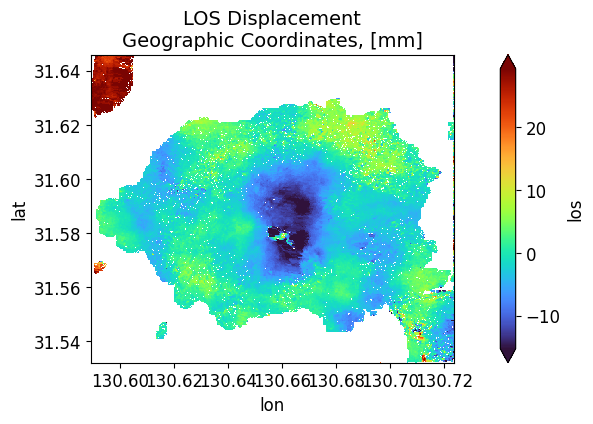

In [ ]:
sbas.plot_displacement(los_disp_mm_ll.where(landmask), caption='LOS Displacement\nGeographic Coordinates, [mm]', quantile=[0.01, 0.99], aspect='equal')
plt.savefig('LOS Displacement Geographic Coordinates, [mm].jpg')

In [ ]:
sbas.export_vtk(los_disp_mm_ll.where(landmask), 'los', mask='auto')

Exporting WGS84 VTK(s):   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# build interactive 3D plot
plotter = pv.Plotter(notebook=True)
plotter.add_mesh(pv.read('los.vtk').scale([1, 1, 0.00002], inplace=True), scalars='los', cmap='turbo', ambient=0.1, show_scalar_bar=True)
plotter.show_axes()
plotter.show(screenshot='3D LOS Displacement.png', jupyter_backend='panel', return_viewer=True)
plotter.add_title(f'Interactive LOS Displacement on DEM', font_size=32)
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='09a...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')

In [ ]:
pip install pyvista panel


In [ ]:
import pyvista as pv
import panel as pn

# 1. PyVistaプロットを作成
plotter = pv.Plotter(notebook=False)
mesh = pv.read('los.vtk')  # 3Dモデルの読み込み
mesh.scale([1, 1, 0.00002], inplace=True)  # 必要に応じてスケール調整
plotter.add_mesh(mesh, scalars='los', cmap='turbo', ambient=0.1, show_scalar_bar=True)
plotter.add_title('Interactive LOS Displacement on DEM', font_size=16)
plotter.show_axes()

# 2. PanelでPyVistaプロットをラップ
pn.config.sizing_mode = 'stretch_width'
pn_viewer = pn.pane.VTK(plotter.ren_win, height=600)  # Panelで表示する3Dビューア

# 3. Panelレイアウトを作成
app = pn.Column(
    pn.pane.Markdown("# Interactive 3D LOS Displacement"),
    pn_viewer
)

# 4. ローカルホストで起動
app.servable()


Column(sizing_mode='stretch_width')
    [0] Markdown(str, sizing_mode='stretch_width')
    [1] VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='b81...], height=600, sizing_mode='stretch_width')